In [1]:
# Data: https://www.kaggle.com/camnugent/california-housing-prices
# Drive: https://drive.google.com/file/d/1eHz4303MWil6lC9Fr6LdGAwCkryiZZqc/view?usp=sharing
!gdown --id 1eHz4303MWil6lC9Fr6LdGAwCkryiZZqc

'gdown' is not recognized as an internal or external command,
operable program or batch file.


In [ ]:
import pandas as pd
df_housing = pd.read_csv('/content/housing.csv')
df_housing

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


1. longitude: A measure of how far west a house is; a higher value is farther west

2. latitude: A measure of how far north a house is; a higher value is farther north

3. housingMedianAge: Median age of a house within a block; a lower number is a newer building

4. totalRooms: Total number of rooms within a block

5. totalBedrooms: Total number of bedrooms within a block

6. population: Total number of people residing within a block

7. households: Total number of households, a group of people residing within a home unit, for a block

8. medianIncome: Median income for households within a block of houses (measured in tens of thousands of US Dollars)

9. medianHouseValue: Median house value for households within a block (measured in US Dollars)

10. oceanProximity: Location of the house w.r.t ocean/sea

In [ ]:
df_housing['ocean_proximity'].unique()

array(['NEAR BAY', '<1H OCEAN', 'INLAND', 'NEAR OCEAN', 'ISLAND'],
      dtype=object)

# Plot Bar Graph to show number of house in each Location

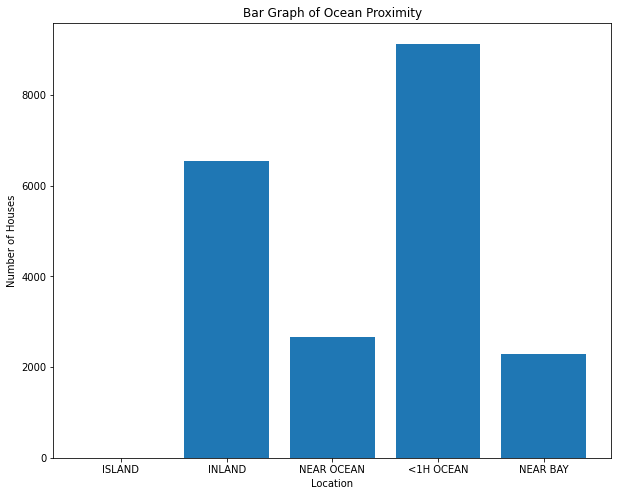

In [ ]:
freq_dict=dict.fromkeys(set(df_housing['ocean_proximity']),0) 
for i in df_housing['ocean_proximity']:
  freq_dict[i]+=1
import matplotlib.pyplot as plt
fig,ax = plt.subplots(figsize = (10,8))
ax.bar(freq_dict.keys(), freq_dict.values())
ax.set_title('Bar Graph of Ocean Proximity')
ax.set_ylabel('Number of Houses')
ax.set_xlabel('Location')
plt.show()

# Plot Histogram of Housing Median Age in each Location

In [ ]:
NEAR_BAY = df_housing[df_housing['ocean_proximity']=='NEAR BAY']
L1Hr_OCEAN = df_housing[df_housing['ocean_proximity']=='<1H OCEAN']
INLAND = df_housing[df_housing['ocean_proximity']=='INLAND']
NEAR_OCEAN = df_housing[df_housing['ocean_proximity']=='NEAR OCEAN']
ISLAND = df_housing[df_housing['ocean_proximity']=='ISLAND']

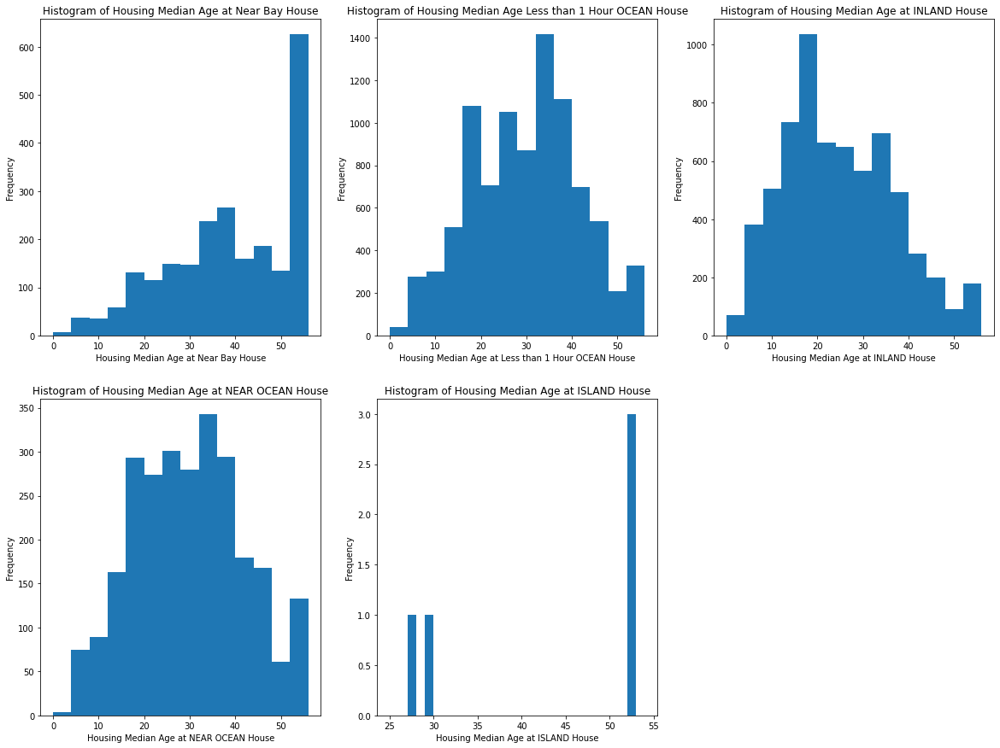

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
fig = plt.figure(figsize = (20,15))
bins = np.arange(0,60,4)
ax1 = fig.add_subplot(231)
ax1.hist(NEAR_BAY['housing_median_age'], bins = bins)
ax1.set_title('Histogram of Housing Median Age at Near Bay House')
ax1.set_ylabel('Frequency')
ax1.set_xlabel('Housing Median Age at Near Bay House')
ax2 = fig.add_subplot(232)
ax2.hist(L1Hr_OCEAN['housing_median_age'], bins = bins)
ax2.set_title('Histogram of Housing Median Age Less than 1 Hour OCEAN House')
ax2.set_ylabel('Frequency')
ax2.set_xlabel('Housing Median Age at Less than 1 Hour OCEAN House')
ax3 = fig.add_subplot(233)
ax3.hist(INLAND['housing_median_age'], bins = bins)
ax3.set_title('Histogram of Housing Median Age at INLAND House')
ax3.set_ylabel('Frequency')
ax3.set_xlabel('Housing Median Age at INLAND House')
ax4 = fig.add_subplot(234)
ax4.hist(NEAR_OCEAN['housing_median_age'], bins = bins)
ax4.set_title('Histogram of Housing Median Age at NEAR OCEAN House')
ax4.set_ylabel('Frequency')
ax4.set_xlabel('Housing Median Age at NEAR OCEAN House')
ax5 = fig.add_subplot(235)
ax5.hist(ISLAND['housing_median_age'], bins = np.arange(25,55))
ax5.set_title('Histogram of Housing Median Age at ISLAND House')
ax5.set_ylabel('Frequency')
ax5.set_xlabel('Housing Median Age at ISLAND House')
plt.show()

# Relation Between Housing Median Age and Median Income and House Location

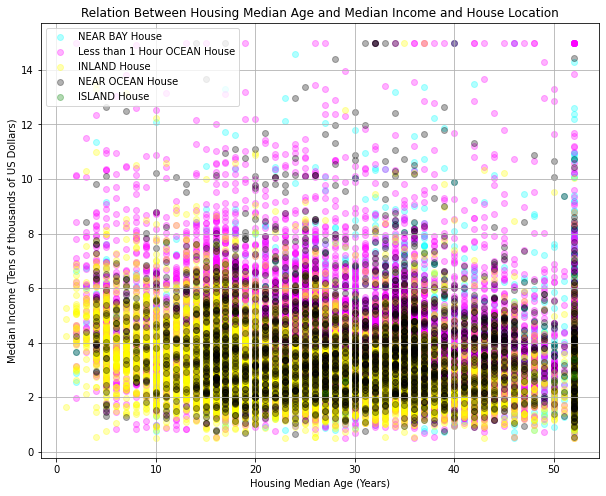

In [ ]:
import matplotlib.pyplot as plt
fig,ax = plt.subplots(figsize = (10,8))
ax.scatter(NEAR_BAY['housing_median_age'], NEAR_BAY['median_income'], color='#00ffff', label = 'NEAR BAY House', alpha=0.3)
ax.scatter(L1Hr_OCEAN['housing_median_age'], L1Hr_OCEAN['median_income'], color='#ff00ff', label = 'Less than 1 Hour OCEAN House', alpha=0.3)
ax.scatter(INLAND['housing_median_age'], INLAND['median_income'], color='#ffff00', label = 'INLAND House', alpha=0.3)
ax.scatter(NEAR_OCEAN['housing_median_age'], NEAR_OCEAN['median_income'], color='#000000', label = 'NEAR OCEAN House', alpha=0.3)
ax.scatter(ISLAND['housing_median_age'], ISLAND['median_income'], color='g', label = 'ISLAND House', alpha=0.3)
ax.set_title('Relation Between Housing Median Age and Median Income and House Location')
ax.set_ylabel('Median Income (Tens of thousands of US Dollars)')
ax.set_xlabel('Housing Median Age (Years)')
ax.legend()
ax.grid(True)
plt.show()

# Map Visualization

In [ ]:
import folium
m = folium.Map(location=[df_housing.latitude.mean()+2, df_housing.longitude.mean()],zoom_start=6)
for index, row in df_housing.iterrows():
  popup_text = "Location: "+row['ocean_proximity']+''' <br>Median House Value: '''+str(row['median_house_value'])+' (US Dollars)'
  #+"<br>Housing Median Age: "+str(row['housing_median_age'])+" (Year)<br>Population: "+str(row['population'])+' <br>Median Income: '+str(row['median_income'])+''' (Tens of Thousands of US Dollars)<br>Median House Value: '''+str(row['median_house_value'])+' (US Dollars)'
  folium.CircleMarker(location=(row["latitude"],
                                row["longitude"]),
                                radius= 5,
                                color=None,
                                popup=popup_text,
                                fill=True,
                                fill_color='#3186cc').add_to(m)
m